# Business Data Science Final Project - Team Lamia

### Richa Bathija - Barrett Poth - Thomas Stamatopoulos - Xinshaung (Susie) Zhao

### 01. Introduction

An existential problem for any major website today is how to handle toxic and divisive content. Quora wants to tackle this problem head-on to keep their platform a place where users can feel safe sharing their knowledge with the world.

Quora is a platform that empowers people to learn from each other. On Quora, people can ask questions and connect with others who contribute unique insights and quality answers. A key challenge is to weed out insincere questions -- those founded upon false premises, or that intend to make a statement rather than look for helpful answers.

In this project we developed a model that identifies and flags insincere questions. While Quora has arleady employed both machine learning and manual review to address this problem through this project we plan to develop more scalable methods to detect toxic and misleading content, as Quora tries to implement its policy of "Be Nice, Be Respectful" to be a place for sharing and growing the world's knowledge.



![Jupyter](https://upload.wikimedia.org/wikipedia/commons/9/91/Quora_logo_2015.svg)

### 02. Data Collection

The idea of the project was initiated due to a relevant Kaggle competition set by the company, using the given datasets as a reliable and unbaised source of data. Collecting the data from the relevant competition we had labeled dataset (sincere: target=0, insincere: taget=1) of 1,306,122 questions that we used to train our model, as well as 56,370 questions that that did not have labels and were used to test our model's prediction accuracy.

In [1]:
import pandas as pd
pd.set_option('display.max_columns', None)
pd.set_option('display.max_colwidth', 200)

In [2]:
data_train = pd.read_csv('train.csv')
data_train.shape

(1306122, 3)

In [3]:
data_train.head()

,qid,question_text,target
0,00002165364db923c7e6,How did Quebec nationalists see their province as a nation in the 1960s?,0
1,000032939017120e6e44,"Do you have an adopted dog, how would you encourage people to adopt and not shop?",0
2,0000412ca6e4628ce2cf,Why does velocity affect time? Does velocity affect space geometry?,0
3,000042bf85aa498cd78e,How did Otto von Guericke used the Magdeburg hemispheres?,0
4,0000455dfa3e01eae3af,Can I convert montra helicon D to a mountain bike by just changing the tyres?,0


In [4]:
data_test = pd.read_csv('test.csv')
data_test.shape

(56370, 2)

In [5]:
data_test.head()

,qid,question_text
0,00014894849d00ba98a9,My voice range is A2-C5. My chest voice goes up to F4. Included sample in my higher chest range. What is my voice type?
1,000156468431f09b3cae,How much does a tutor earn in Bangalore?
2,000227734433360e1aae,What are the best made pocket knives under $200-300?
3,0005e06fbe3045bd2a92,Why would they add a hypothetical scenario that’s impossible to happen in the link below? It shows what 800 meters rise in sea level would look like.
4,00068a0f7f41f50fc399,What is the dresscode for Techmahindra freshers?


### 03. Data Analysis

Below are all the libraries and tools that were used for the analysis of our training data, kept together in one cell for houskeeping purposes.

In [17]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import warnings 
import time
import gc

import bokeh.plotting as bp
from bokeh.models import HoverTool, BoxSelectTool
from bokeh.models import ColumnDataSource
from bokeh.plotting import figure, show, output_notebook, reset_output
from bokeh.palettes import d3
import bokeh.models as bmo
from bokeh.io import save, output_file

import re
import string
import nltk
from nltk.tokenize import word_tokenize, sent_tokenize, TweetTokenizer
from nltk.corpus import stopwords
from nltk.stem.wordnet import WordNetLemmatizer 




from collections import Counter
from nltk.util import ngrams
from appos import * # import APPOS dictionary

from sklearn.feature_extraction.text import TfidfVectorizer, CountVectorizer
from sklearn.decomposition import LatentDirichletAllocation
from sklearn.model_selection import GridSearchCV
from sklearn.manifold import TSNE

from wordcloud import WordCloud

np.random.seed(32)
color = sns.color_palette("Set2")
warnings.filterwarnings("ignore")
stop_words = set(stopwords.words("english"))
punctuations = string.punctuation
output_notebook()

%matplotlib inline

train = data_train

Loading BokehJS ...

**NULL VALUES**

As a first step, we take a look at the training data identifying if there are any null values.

In [8]:
train.isna().sum()

qid              0
question_text    0
target           0
dtype: int64

It turns out that there were no null values, which is a good first indication of the quality of our dataset.

# Target Distribution

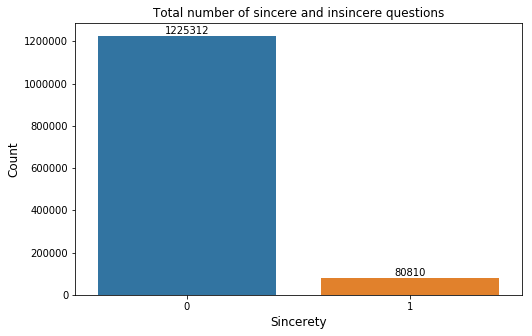

In [9]:
target_count = train["target"].value_counts()

plt.figure(figsize = (8, 5))
plt.xlabel("Sincerety", fontsize = 12)
plt.ylabel("Count", fontsize = 12)
plt.title("Total number of sincere and insincere questions", fontsize = 12)
ax = sns.barplot(target_count.index, target_count.values)
rects = ax.patches
labels = target_count.values
for rect, label in zip(rects, labels):
    ax.text(rect.get_x() + rect.get_width()/2, rect.get_height() + 5,
           label, ha = "center", va = "bottom")
plt.show()

**SKEWNESS**

Next we dig deep further into the data and check how skewed it is in regards to the sincerety of the questions.

In [10]:
# calculating percentage of sincerer questions
senc_perc = train[train['target'] == 0]
inse_perc = train[train['target'] == 1]
round((len(senc_perc) / (len(senc_perc)+len(inse_perc)))*100,2)

93.81

As expected our dataset is strongly skewed with 93.81% being sincere, most people posting questions seem to have real questions that they want to get answer and have good intentions. For our analysis, this means that we cannot use accuracy as our prediction metric, but rather use ROC score.

# Question Length Distribution

Another important metric is the overall length of the questions as more words, mean more features.

In [11]:
# creating new feature - question length
train["quest_len"] = train["question_text"].apply(lambda x: len(x.split()))

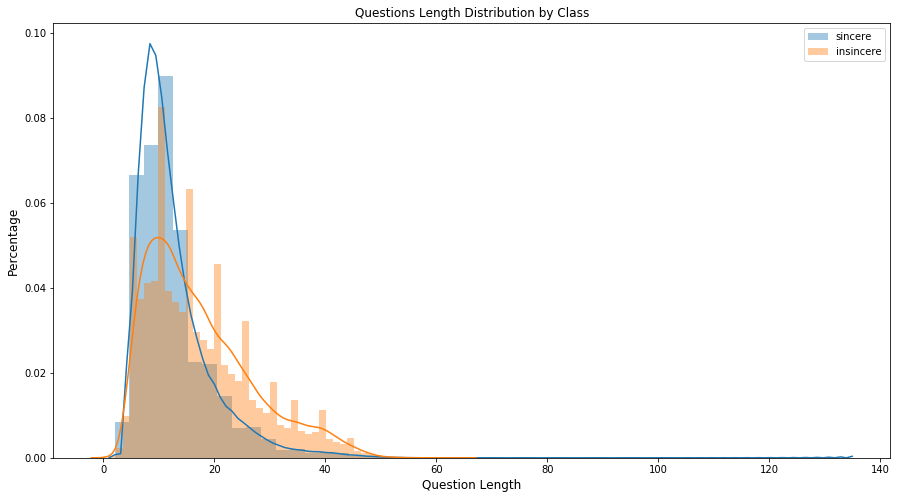

In [12]:
sincere = train[train["target"] == 0]
insincere = train[train["target"] == 1]

plt.figure(figsize = (15, 8))
sns.distplot(sincere["quest_len"], hist = True, label = "sincere")
sns.distplot(insincere["quest_len"], hist = True, label = "insincere")
plt.legend(fontsize = 10)
plt.title("Questions Length Distribution by Class", fontsize = 12)
plt.xlabel("Question Length", fontsize = 12)
plt.ylabel("Percentage", fontsize = 12)
plt.show()

Based on the above, and taking into account the high skewness of the data, it appears that insincere questions tend to be longer while at any case most questions are between 5 to 20 words long indicating their simplicity and forwardness.

**DATA CLEANING**

Given the already identified simplicity of the questions, we will try to standardize their writting style by removing apostrophes and replacing them with the complete texts and then the question words, replacing them with their dictionary forms.

In [14]:
#https://drive.google.com/file/d/0B1yuv8YaUVlZZ1RzMFJmc1ZsQmM/view
# Aphost lookup dict
APPO = {
"aren't" : "are not", "can't" : "cannot", "couldn't" : "could not", "didn't" : "did not", "doesn't" : "does not",
"don't" : "do not", "hadn't" : "had not", "hasn't" : "has not", "haven't" : "have not", "he'd" : "he would",
"he'll" : "he will", "he's" : "he is", "i'd" : "I would", "i'd" : "I had", "i'll" : "I will", "i'm" : "I am",
"isn't" : "is not", "it's" : "it is", "it'll":"it will", "i've" : "I have", "let's" : "let us", 
"mightn't" : "might not", "mustn't" : "must not", "shan't" : "shall not", "she'd" : "she would", 
"she'll" : "she will", "she's" : "she is", "shouldn't" : "should not", "that's" : "that is", 
"there's" : "there is", "they'd" : "they would", "they'll" : "they will", "they're" : "they are",
"they've" : "they have", "we'd" : "we would", "we're" : "we are", "weren't" : "were not", "we've" : "we have",
"what'll" : "what will", "what're" : "what are", "what's" : "what is", "what've" : "what have",
"where's" : "where is", "who'd" : "who would", "who'll" : "who will", "who're" : "who are", "who's" : "who is",
"who've" : "who have", "won't" : "will not", "wouldn't" : "would not", "you'd" : "you would", 
"you'll" : "you will", "you're" : "you are", "you've" : "you have", "'re": " are", "wasn't": "was not",
"we'll":" will", "didn't": "did not", "tryin'":"trying", "aren't" : "are not", "can't" : "cannot", "couldn't" : "could not",
"didn't" : "did not", "doesn't" : "does not", "don't" : "do not", "hadn't" : "had not", "hasn't" : "has not",
"haven't" : "have not", "he'd" : "he would", "he'll" : "he will", "he's" : "he is", "i'd" : "I would", "i'd" : "I had",
"i'll" : "I will", "i'm" : "I am", "isn't" : "is not", "it's" : "it is", "it'll":"it will", "i've" : "I have", "let's" : "let us",
"mightn't" : "might not", "mustn't" : "must not", "shan't" : "shall not", "she'd" : "she would", "she'll" : "she will",
"she's" : "she is", "shouldn't" : "should not", "that's" : "that is", "there's" : "there is", "they'd" : "they would",
"they'll" : "they will", "they're" : "they are", "they've" : "they have", "we'd" : "we would", "we're" : "we are",
"weren't" : "were not", "we've" : "we have", "what'll" : "what will", "what're" : "what are", "what's" : "what is",
"what've" : "what have", "where's" : "where is", "who'd" : "who would", "who'll" : "who will", "who're" : "who are",
"who's" : "who is", "who've" : "who have", "won't" : "will not", "wouldn't" : "would not", "you'd" : "you would",
"you'll" : "you will", "you're" : "you are", "you've" : "you have", "'re": " are", "wasn't": "was not", "we'll":" will",
"didn't": "did not"
}

In [18]:
lem = WordNetLemmatizer()
tokenizer = TweetTokenizer()

def clean(question):
#     question = question.lower() 
#     question = re.sub("\\n", "", question)
#     question = re.sub("\'", "", question)
#     words = tokenizer.tokenize(question)
#     words = [APPO[word] if word in APPO else word for word in words]
#     words = [lem.lemmatize(word, "v") for word in words]
#     words = [w for w in words if w not in stop_words and w not in punctuations]
    question = question.lower()
    tk = re.sub("[^a-zA-Z]", " ", question).split()
    tk = [appos[word] if word in appos else word for word in tk]
    qs = " ".join(tk)
    words = nltk.word_tokenize(qs)
    words = [w for w in words if w not in stop_words and w not in punctuations]
    
    
#     tk = nltk.word_tokenize(qs)
#     tk = re.sub("[^a-zA-Z]", " ", qs).split()
#     tk = [token.lower() for token in tk]
#     tk = [APPO[word] if word in APPO else word for word in tk]
#     words = [w for w in tk if w not in stop_words and w not in punctuations]
    return " ".join(words)
  

print(nltk.word_tokenize("i believe they wouldn't do that"))
print(clean("i believe they wouldn't do that"))
re.sub("[^a-zA-Z]", " ", "i believe they wouldn't do that").split()

['i', 'believe', 'they', 'would', "n't", 'do', 'that']
believe


['i', 'believe', 'they', 'wouldn', 't', 'do', 'that']

## Data Cleaning

In [19]:
sincere["clean_question_text"] = sincere["question_text"].apply(lambda question: clean_text(question))
insincere["clean_question_text"] = insincere["question_text"].apply(lambda question: clean_text(question))

In [20]:
insincere.head()

,qid,question_text,target,quest_len,clean_question_text
22,0000e91571b60c2fb487,Has the United States become the largest dictatorship in the world?,1,11,unite state become largest dictatorship world
30,00013ceca3f624b09f42,Which babies are more sweeter to their parents? Dark skin babies or light skin babies?,1,15,baby sweeter parent dark skin baby light skin baby
110,0004a7fcb2bf73076489,If blacks support school choice and mandatory sentencing for criminals why don't they vote Republican?,1,15,black support school choice mandatory sentence criminals dont vote republican
114,00052793eaa287aff1e1,"I am gay boy and I love my cousin (boy). He is sexy, but I dont know what to do. He is hot, and I want to see his di**. What should I do?",1,34,gay boy love cousin boy sexy dont know hot want see di
115,000537213b01fd77b58a,Which races have the smallest penis?,1,6,race smallest penis


Next using these "clean text" questions, we can run Latent Dirichlet Allocation in order to identify underlying themes and motives of the questions.

# **INSINCERE QUESTIONS TOPIC MODELING**

First we convert our collection of questions to a matrix of token counts, taking into account bi-grams as well and also removing the english stop words. We are focusing on the insincere questions, since we are trying to identify what is it that makes them insincere and how they differ in general.

In [22]:
cv = CountVectorizer(min_df = 10,
                     max_features = 100000,
                     analyzer = "word",
                     ngram_range = (1, 2),
                     stop_words = "english",
                     token_pattern = '[a-zA-Z]')

count_vectors = cv.fit_transform(insincere["clean_question_text"])

In [29]:
from gensim.test.utils import common_texts
from gensim.corpora.dictionary import Dictionary
from sklearn.decomposition import LatentDirichletAllocation

In [ ]:
# params = {"n_components": [5, 10, 20, 30, 40, 50]}

# lda_model = LatentDirichletAllocation(n_components = n_topics, 
#                                       # we choose a small n_components for time convenient
#                                       # will find a appropriate n_components later 
#                                       learning_method = "online",
#                                       batch_size = 128,
#                                       evaluate_every = -1,
#                                       max_iter = 20,
#                                       random_state = 32,
#                                       n_jobs = -1)

# model = GridSearchCV(lda_model, param_grid = params)
# model.fit(count_vectors)

# best_lda_model = model.best_estimator_
# best_lda_model

After applying Grid Search, we found the optimial **n_components** is between 5 to 10. In this case, we pick the 'mean' which is 8.

In [15]:
n_topics = 8
lda_model = LatentDirichletAllocation(n_components = n_topics, 
                                      learning_method = "online",
                                      batch_size = 128,
                                      evaluate_every = -1,
                                      max_iter = 20,
                                      random_state = 32,
                                      n_jobs = -1)

question_topics = lda_model.fit_transform(count_vectors)
temp = question_topics

To get a better LDA model, we need to maximize log likelihood and minimize perplexity.

In [16]:
print("Log Likelihood: {} \nPerplexity: {}".format(lda_model.score(count_vectors), 
                                                   lda_model.perplexity(count_vectors)))

Log Likelihood: -34139639.4664356 
Perplexity: 123.05653246670964


**tsne is an algorithm for dimensionality reduction. We are using this model to getter a better visualization of the probabilities of the topics.** 

In [17]:
tsne_model = TSNE(n_components = 2, verbose = 1, random_state = 32, n_iter = 500)
tsne_lda = tsne_model.fit_transform(question_topics)

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 80810 samples in 0.122s...
[t-SNE] Computed neighbors for 80810 samples in 11.369s...
[t-SNE] Computed conditional probabilities for sample 1000 / 80810
[t-SNE] Computed conditional probabilities for sample 2000 / 80810
[t-SNE] Computed conditional probabilities for sample 3000 / 80810
[t-SNE] Computed conditional probabilities for sample 4000 / 80810
[t-SNE] Computed conditional probabilities for sample 5000 / 80810
[t-SNE] Computed conditional probabilities for sample 6000 / 80810
[t-SNE] Computed conditional probabilities for sample 7000 / 80810
[t-SNE] Computed conditional probabilities for sample 8000 / 80810
[t-SNE] Computed conditional probabilities for sample 9000 / 80810
[t-SNE] Computed conditional probabilities for sample 10000 / 80810
[t-SNE] Computed conditional probabilities for sample 11000 / 80810
[t-SNE] Computed conditional probabilities for sample 12000 / 80810
[t-SNE] Computed conditional probabilities for sa

In [18]:
question_topics = np.matrix(question_topics)
doc_topics = question_topics/question_topics.sum(axis = 1)

lda_keys = []
for i, tweet in enumerate(insincere["question_text"]):
    lda_keys += [doc_topics[i].argmax()]
    
tsne_lda_df = pd.DataFrame(tsne_lda, columns = ["x", "y"])
tsne_lda_df["qid"] = insincere["qid"].values
tsne_lda_df["question"] = insincere["question_text"].values
tsne_lda_df["topics"] = lda_keys
tsne_lda_df["topics"] = tsne_lda_df["topics"].map(int)

In [19]:
import random

def generate_color():
    color = "#{:02x}{:02x}{:02x}".format(*map(lambda x: random.randint(0, 255), range(3)))
    return color

In [20]:
colormap = np.array([generate_color() for t in range(n_topics)])

In [21]:
plot_lda = bp.figure(plot_width = 700, plot_height = 600, 
                    title = "LDA topics of Quora Questions",
                    tools = "pan, wheel_zoom, box_zoom, reset, hover, previewsave",
                    x_axis_type = None, y_axis_type = None, min_border = 1)

source = ColumnDataSource(data = dict(x = tsne_lda_df["x"], y = tsne_lda_df["y"],
                         color = colormap[lda_keys],
                         qid = tsne_lda_df["qid"],
                         question = tsne_lda_df["question"],
                         topics = tsne_lda_df["topics"]))

plot_lda.scatter(x = "x", y = "y", color = "color", source = source)
hover = plot_lda.select(dict(type = HoverTool))
hover.tooltips = {"qid": "@qid","question": "@question", "topics": "@topics"}
show(plot_lda)

**Although we can see some patterns in the visualization from above, the graph is difficult to interpret.  The very reason for that is our model is unable to confidently assign a topic to every questions. This means that there are questions being assigned a low probability to a probable topic. To filter out such questions, we simply add a threshold factor.**

#### Topic Probability => 0.5

In [22]:
threshold = 0.5
idx = np.amax(temp, axis = 1) >= threshold
question_topics = temp[idx]

In [23]:
tsne_model = TSNE(n_components = 2, verbose = 1, random_state = 32, n_iter = 500)
tsne_lda2 = tsne_model.fit_transform(question_topics)


[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 33177 samples in 0.038s...
[t-SNE] Computed neighbors for 33177 samples in 2.051s...
[t-SNE] Computed conditional probabilities for sample 1000 / 33177
[t-SNE] Computed conditional probabilities for sample 2000 / 33177
[t-SNE] Computed conditional probabilities for sample 3000 / 33177
[t-SNE] Computed conditional probabilities for sample 4000 / 33177
[t-SNE] Computed conditional probabilities for sample 5000 / 33177
[t-SNE] Computed conditional probabilities for sample 6000 / 33177
[t-SNE] Computed conditional probabilities for sample 7000 / 33177
[t-SNE] Computed conditional probabilities for sample 8000 / 33177
[t-SNE] Computed conditional probabilities for sample 9000 / 33177
[t-SNE] Computed conditional probabilities for sample 10000 / 33177
[t-SNE] Computed conditional probabilities for sample 11000 / 33177
[t-SNE] Computed conditional probabilities for sample 12000 / 33177
[t-SNE] Computed conditional probabilities for sam

In [24]:
new_insincere = insincere[["qid", "question_text"]].copy()
new_insincere = new_insincere[idx]

In [25]:
question_topics = np.matrix(question_topics)
doc_topics = question_topics/question_topics.sum(axis = 1)

lda_keys = []
for i, tweet in enumerate(new_insincere["question_text"]):
    lda_keys += [doc_topics[i].argmax()]
    
tsne_lda_df2 = pd.DataFrame(tsne_lda2, columns = ["x", "y"])
tsne_lda_df2["qid"] = new_insincere["qid"].values
tsne_lda_df2["question"] = new_insincere["question_text"].values
tsne_lda_df2["topics"] = lda_keys
tsne_lda_df2["topics"] = tsne_lda_df2["topics"].map(int)

In [26]:
plot_lda = bp.figure(plot_width = 700, plot_height = 600, 
                    title = "LDA topics of Quora Questions",
                    tools = "pan, wheel_zoom, box_zoom, reset, hover, previewsave",
                    x_axis_type = None, y_axis_type = None, min_border = 1)

source = ColumnDataSource(data = dict(x = tsne_lda_df2["x"], y = tsne_lda_df2["y"],
                         color = colormap[lda_keys],
                         qid = tsne_lda_df2["qid"],
                         question = tsne_lda_df2["question"],
                         topics = tsne_lda_df2["topics"]))

plot_lda.scatter(x = "x", y = "y", color = "color", source = source)
hover = plot_lda.select(dict(type = HoverTool))
hover.tooltips = {"qid": "@qid", "question": "@question", "topics": "@topics"}
show(plot_lda)

**We get a much better visualization after using probability threshold.**

#### Topic Probability < 0.5

In [27]:
idx = np.amax(temp, axis = 1) < threshold
question_topics = temp[idx]

In [28]:
tsne_model = TSNE(n_components = 2, verbose = 1, random_state = 32, n_iter = 500)
tsne_lda3 = tsne_model.fit_transform(question_topics)

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 47633 samples in 0.065s...
[t-SNE] Computed neighbors for 47633 samples in 7.555s...
[t-SNE] Computed conditional probabilities for sample 1000 / 47633
[t-SNE] Computed conditional probabilities for sample 2000 / 47633
[t-SNE] Computed conditional probabilities for sample 3000 / 47633
[t-SNE] Computed conditional probabilities for sample 4000 / 47633
[t-SNE] Computed conditional probabilities for sample 5000 / 47633
[t-SNE] Computed conditional probabilities for sample 6000 / 47633
[t-SNE] Computed conditional probabilities for sample 7000 / 47633
[t-SNE] Computed conditional probabilities for sample 8000 / 47633
[t-SNE] Computed conditional probabilities for sample 9000 / 47633
[t-SNE] Computed conditional probabilities for sample 10000 / 47633
[t-SNE] Computed conditional probabilities for sample 11000 / 47633
[t-SNE] Computed conditional probabilities for sample 12000 / 47633
[t-SNE] Computed conditional probabilities for sam

In [29]:
new_insincere2 = insincere[["qid", "question_text"]].copy()
new_insincere2 = new_insincere2[idx]

In [30]:
question_topics = np.matrix(question_topics)
doc_topics = question_topics/question_topics.sum(axis = 1)

lda_keys = []
for i, tweet in enumerate(new_insincere2["question_text"]):
    lda_keys += [doc_topics[i].argmax()]
    
tsne_lda_df3 = pd.DataFrame(tsne_lda3, columns = ["x", "y"])
tsne_lda_df3["qid"] = new_insincere2["qid"].values
tsne_lda_df3["question"] = new_insincere2["question_text"].values
tsne_lda_df3["topics"] = lda_keys
tsne_lda_df3["topics"] = tsne_lda_df2["topics"].map(int)

In [31]:
plot_lda = bp.figure(plot_width = 700, plot_height = 600, 
                    title = "LDA topics of Quora Questions",
                    tools = "pan, wheel_zoom, box_zoom, reset, hover, previewsave",
                    x_axis_type = None, y_axis_type = None, min_border = 1)

source = ColumnDataSource(data = dict(x = tsne_lda_df3["x"], y = tsne_lda_df3["y"],
                         color = colormap[lda_keys],
                         qid = tsne_lda_df3["qid"],
                         question = tsne_lda_df3["question"],
                         topics = tsne_lda_df3["topics"]))

plot_lda.scatter(x = "x", y = "y", color = "color", source = source)
hover = plot_lda.select(dict(type = HoverTool))
hover.tooltips = {"qid": "@qid", "question": "@question", "topics": "@topics"}
show(plot_lda)

## Insincere Topic Wordcloud

**Here we will create a wordcloud to depict as to which words occur more often in the chosen topics. Word Cloud is a data visualization technique used for representing text data in which the size of each word indicates its frequency or importance.**

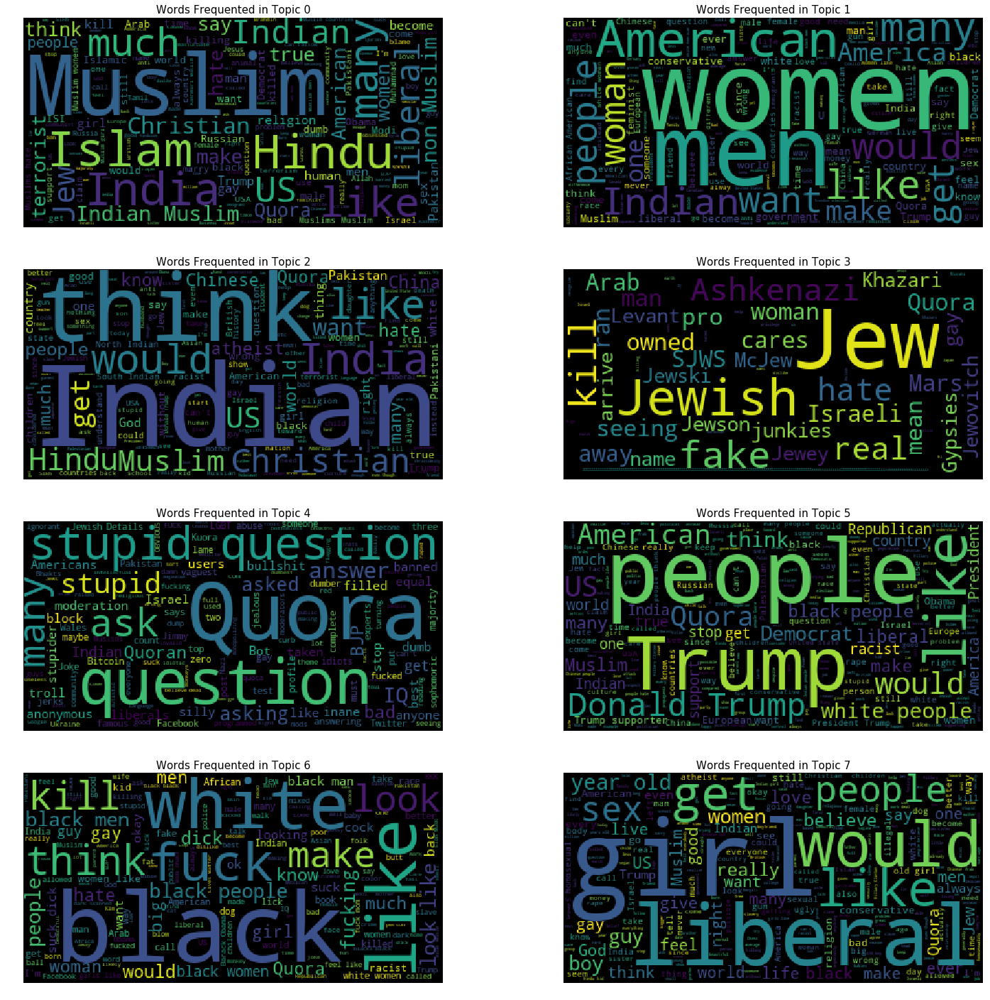

In [32]:
def create_wordcloud(i, data):
#     plt.subplot(int("52{}".format(ax+1)))
    wc =  WordCloud(max_words = 1000, stopwords = stop_words)
    wc.generate(" ".join(data))
    ax[int(i/2)][i%2].axis("off")
    ax[int(i/2)][i%2].set_title("Words Frequented in Topic {}".format(i), fontsize = 15)
    ax[int(i/2)][i%2].imshow(wc)
    
fig, ax = plt.subplots(4, 2, figsize = (25, 25))
for i in range(n_topics):
    text = tsne_lda_df[tsne_lda_df["topics"] == int(i)]["question"]
    create_wordcloud(int(i), text)

**From the word clouds generated above for each we get the following insights:**
    
**Topic 1:**

Words such as Muslim, Islam, Hindu, Christian, Russian, Religion, India, US, have been repeated more often or are more important. We find a sense of racism here and thus believe that racist comments have been made as a part of insincere questions.

**Topic 2:**

Words such as American, Women, Man, Girl have been repeated more often. Thus we get an insight that "gender bias" related questions have been posted on Quora which qualify as insincere questions.

**Topic 3:**

Words such as Hindu, Muslim, Christian etc have been repeated which again point to racism.

**Topic 4:**

Words such as Fake, Jew, Jewish etc have been repeated more often which are insincere.

**Topic 5:**

This topic pretty much points out to the same issues as above.

**Topic 6:**

Words such as American, Trump, Donald, Democratic, White, People have been repeated more often which point out to the insincere questions during the elections. People tend to lean on hard towards one party and tend to demean the opposition party.

**Topic 7:**

The words in this topic point more towards racism again.

**Topic 8:**

This topic more or the less points towards gender bias.

**Above all, we get an insight that the insincere question mainly target Racism, Gender and Politics. Hence it becomes a little easier for us now to detect insincere question.**

## Topic Network

Related paper: [Topic Modeling and Network Visualization to
Explore Patient Experiences](http://faculty.washington.edu/atchen/pubs/Chen_Sheble_Eichler_VAHC2013.pdf)

In [33]:
import networkx as nx
from scipy.cluster.hierarchy import linkage, dendrogram
from scipy.spatial.distance import pdist, squareform

cor = squareform(pdist(tsne_lda2, metric = "euclidean"))

In [34]:
cor = squareform(pdist(tsne_lda2[:100], metric = "euclidean"))

In [35]:
labels = {}

for l, i in enumerate(tsne_lda_df2["qid"]):
    labels[l] = i

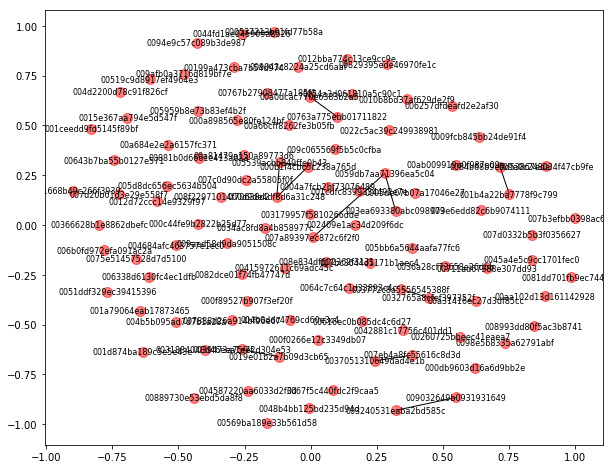

In [36]:
G = nx.Graph()

for i in range(cor.shape[0]):
    for j in range(cor.shape[1]):
        if i == j:
            G.add_edge(i, j, weight = 0)
        else:
            G.add_edge(i, j, weight = 1.0/cor[i, j])
            
G = nx.relabel_nodes(G, labels)
            
edges = [(i, j) for i, j, w in G.edges(data = True) if w["weight"] > 0.8]
edge_weight = dict([((u, v, ), int(d["weight"])) for u, v, d in G.edges(data = True)])

pos = nx.spring_layout(G)

plt.figure(figsize = (10, 8))
nx.draw_networkx_nodes(G, pos, node_size = 100, alpha = 0.5)
nx.draw_networkx_edges(G, pos, edgelist = edges, width = 1)
nx.draw_networkx_labels(G, pos, font_size = 8, font_family = "sans-serif")
plt.show()

# Word Frequency Analysis

In this section we aim to find the word frequency analysis of both sincere as well as insincere question after cleaning the text.
After getting a frequency of words, i.e which word occurs the most in the sincere and insincere set, we can get a clear view as to target which part of speech and which words are the ones which are most commonly used in insincere questions

Here we are getting a word frequency analysis of unigrams, bigrams and trigrams.

In [40]:
sincere_df = train[train["target"] == 0]
insincere_df = train[train["target"] == 1]
print("Number of questions labeled with sincere:", len(sincere_df))
print("Number of questions labeled with insincere:",len(insincere_df))

Number of questions labeled with sincere: 1225312
Number of questions labeled with insincere: 80810


In [41]:
sin_qs = sincere_df['question_text'] #test with 1000 questions, should modify later
insin_qs = insincere_df['question_text']#test with 1000 questions, should modify later
clean_sin = sin_qs.apply(clean)
clean_insin = insin_qs.apply(clean)

In [42]:
sin_qs.apply(clean)[:5]

0                quebec nationalists see province nation
1          adopted dog would encourage people adopt shop
2    velocity affect time velocity affect space geometry
3           otto von guericke used magdeburg hemispheres
4    convert montra helicon mountain bike changing tyres
Name: question_text, dtype: object

In [37]:
def unigrams_freq_20(qs):
    frequencies = Counter([])
    for text in qs:
        token = nltk.word_tokenize(text)
        bigrams = ngrams(token, 1)
        frequencies += Counter(bigrams)
    labels=[]
    values=[]
    for i in frequencies.most_common(20):
        labels.append(i[0])
        values.append(i[1])
    return labels, values
  
def bigrams_freq_20(qs):
    frequencies = Counter([])
    for text in qs:
        token = nltk.word_tokenize(text)
        bigrams = ngrams(token, 2)
        frequencies += Counter(bigrams)
    labels=[]
    values=[]
    for i in frequencies.most_common(20):
        labels.append(i[0])
        values.append(i[1])
    return labels, values
  
def trigrams_freq_20(qs):
    frequencies = Counter([])
    for text in qs:
        token = nltk.word_tokenize(text)
        bigrams = ngrams(token, 3)
        frequencies += Counter(bigrams)
    labels=[]
    values=[]
    for i in frequencies.most_common(20):
        labels.append(i[0])
        values.append(i[1])
    return labels, values

In [38]:
def plot(clean_sin, clean_insin, freqfunc ):
  sin_labels, sin_values = freqfunc(clean_sin)
  insin_labels, insin_values = freqfunc(clean_insin)
  plt.figure(figsize=(10,5))

  plt.subplot(121)
  sin_y_pos = np.arange(len(sin_labels))
  plt.barh( sin_y_pos, sin_values, align='center', alpha=0.4)
  plt.yticks(sin_y_pos,sin_labels)
  plt.xlabel('frequency')
  plt.title('most frequent 20 bigrams in sincere questions')
  plt.gca().invert_yaxis() 

  plt.subplot(122)
  insin_y_pos = np.arange(len(insin_labels))
  plt.barh( insin_y_pos, insin_values, align='center', alpha=0.4)
  plt.yticks(insin_y_pos,insin_labels)
  plt.xlabel('frequency')
  plt.title('most frequent 20 bigrams in insincere questions')
  plt.gca().invert_yaxis() 

  plt.tight_layout()
  plt.show()
  

In [43]:
plot(clean_sin, clean_insin,unigrams_freq_20) 

KeyboardInterrupt: 

In [ ]:
plot(clean_sin, clean_insin,bigrams_freq_20)

In [ ]:
plot(clean_sin, clean_insin,trigrams_freq_20)